In [4]:
!pip install matplotlib

  Using cached matplotlib-3.6.3-cp39-cp39-macosx_10_12_x86_64.whl (7.3 MB)
  Using cached kiwisolver-1.4.4-cp39-cp39-macosx_10_9_x86_64.whl (65 kB)
  Using cached cycler-0.11.0-py3-none-any.whl (6.4 kB)
  Using cached pyparsing-3.0.9-py3-none-any.whl (98 kB)
  Using cached contourpy-1.0.7-cp39-cp39-macosx_10_9_x86_64.whl (244 kB)
  Using cached fonttools-4.38.0-py3-none-any.whl (965 kB)


In [1]:
# (16-726): Project 1 starter Python code
# credit to https://inst.eecs.berkeley.edu/~cs194-26/fa18/hw/proj1/data/colorize_skel.py
# these are just some suggested libraries
# instead of scikit-image you could use matplotlib and opencv to read, write, and display images

import numpy as np
import skimage as sk
import skimage.io as skio
import skimage.transform
import os
from functools import partial


In [5]:
skio.use_plugin('matplotlib', 'imshow')


# The following plug-ins are available:

# ========== ==============================================================
# Plugin     Description
# ---------- --------------------------------------------------------------
# qt         Fast image display using the Qt library. Deprecated since
#            0.18. Will be removed in 0.20.
# imread     Image reading and writing via imread
# gdal       Image reading via the GDAL Library (www.gdal.org)
# simpleitk  Image reading and writing via SimpleITK
# gtk        Fast image display using the GTK library
# pil        Image reading via the Python Imaging Library
# fits       FITS image reading via PyFITS
# matplotlib Display or save images using Matplotlib
# tifffile   Load and save TIFF and TIFF-based images using tifffile.py
# imageio    Image reading via the ImageIO Library
# ========== ==============================================================()

In [6]:
def show(im):
    skio.imshow(im)
    skio.show()

In [10]:

# name of the input file
imname = 'data/emir.tif'

# read in the image
im = skio.imread(imname)

def get_channels(im):
    # convert to double (might want to do this later on to save memory)
    im = sk.img_as_float(im)

    # compute the height of each part (just 1/3 of total)
    height = np.floor(im.shape[0] / 3.0).astype(np.int64)

    # separate color channels
    b = im[:height]
    g = im[height: 2*height]
    r = im[2*height: 3*height]
    return r,g,b
r,g,b = get_channels(im)


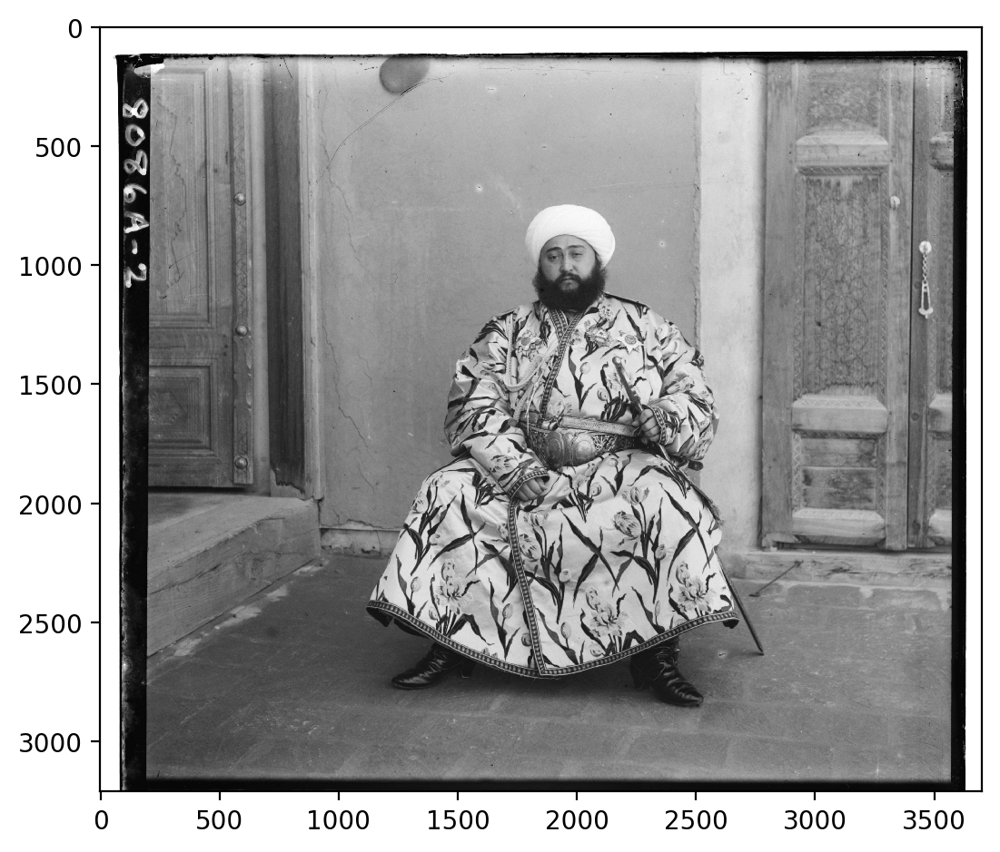

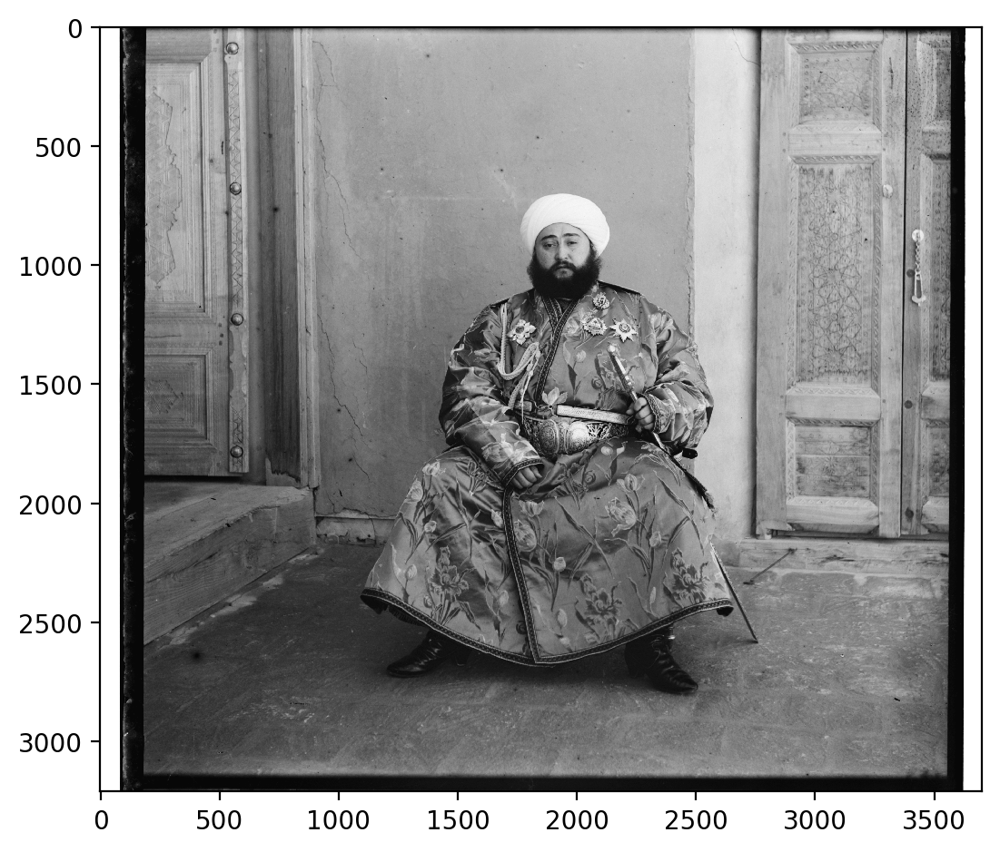

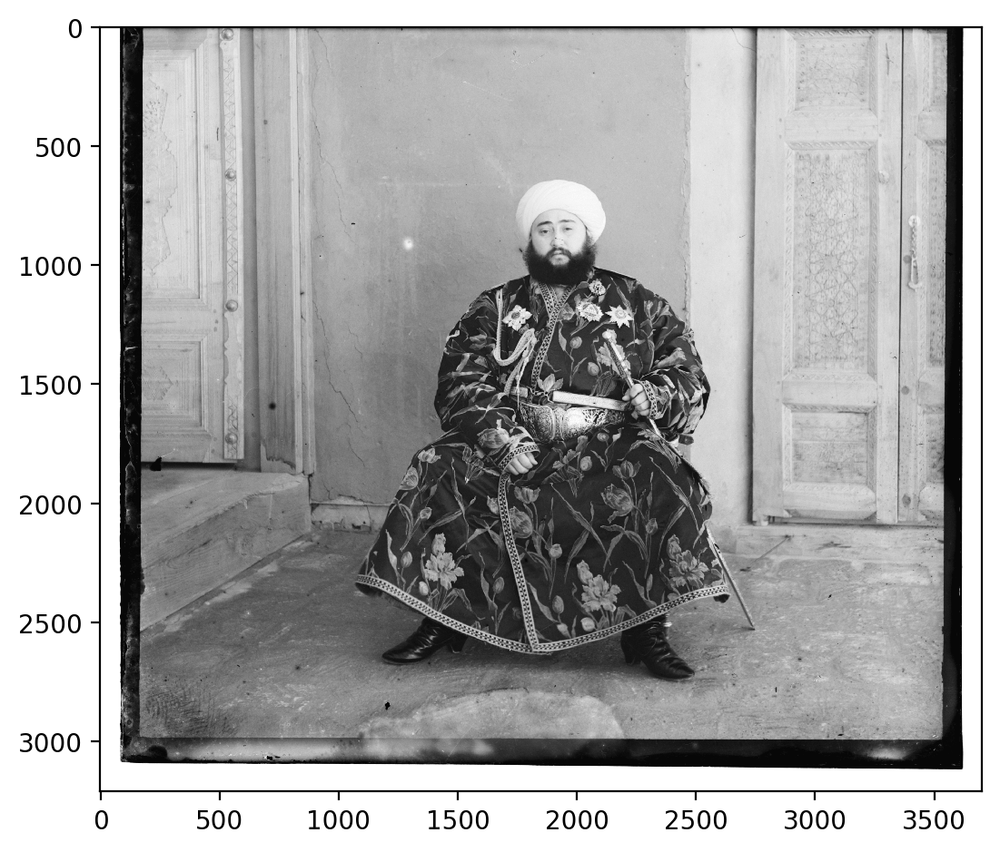

In [11]:
for channel in (b,g,r):
    skio.imshow(channel)
    skio.show()

In [84]:
# aligning, stacking, post_processing algorithms
def dumb_stack(r,g,b):
    return np.dstack([r, g, b]), (0,0), (0,0)
def ssd_brute_force_stack(r,g,b):
    """
    Align channels by minimizing sum of squared differences.
    L2 norm also known as the Sum of Squared Differences (SSD) distance 
    which is simply sum(sum((image1-image2).^2)) 
    where the sum is taken over the pixel values.

    Args:
        r (np.ndarray): channel that is not aligned with the other two
        g (np.ndarray): channel that is not aligned with the other two
        b (np.ndarray): channel that is not aligned with the other two
    """
    def preprocess(channel):
        h, w = channel.shape
        channel = sk.transform.rescale(channel, 1/4) # scale down to reduce search space
        return channel

    def align(c1, c2):
        """align by ssd two channels"""
        scaled1 = preprocess(c1)
        scaled2 = preprocess(c2)
        min_ssd = np.Inf
        argmin_dx = 0
        argmin_dy = 0
        for dx in range(-10,10):
            for dy in range(-5,40):
                shifted = np.roll(scaled1, dx, axis=1)
                shifted = np.roll(shifted, dy, axis=0)
                ssd = np.sum(np.power(scaled2-shifted, 2))
                if ssd < min_ssd:
                    min_ssd = ssd
                    argmin_dx = dx
                    argmin_dy = dy
        c1 = np.roll(c1, argmin_dy*4, 0)
        c1 = np.roll(c1, argmin_dx*4, 1)
        return c1, (argmin_dy*4, argmin_dx*4)
    ag, g_shift = align(g, b)
    ar, r_shift = align(r, b)
    # show(np.dstack([ar, ag, b]))
    # show(dumb_stack(r,g,b))
    return np.dstack([ar, ag, b]), r_shift, g_shift

def ncc_brute_force_stack(r,g,b, crop=False):
    """
    normalized cross-correlation (NCC), which is simply a dot product 
    between two normalized vectors: (image1./||image1|| and image2./||image2||).

    Args:
        r (np.ndarray): channel that is not aligned with the other two
        g (np.ndarray): channel that is not aligned with the other two
        b (np.ndarray): channel that is not aligned with the other two
    """
    def preprocess(channel):
        h, w = channel.shape
        if crop:
            channel = channel[h//10:h-h//10, w//10:w-w//10] # only keep center 80%
        channel = sk.transform.rescale(channel, 1/4) # scale down to reduce search space
        channel = (channel-channel.mean())/channel.std() # normalizem
        return channel

    def align(c1, c2):
        """align by ssd two channels"""
        scaled1 = preprocess(c1)
        scaled2 = preprocess(c2)
        min_ncc = np.Inf
        argmin_dx = 0
        argmin_dy = 0
        for dx in range(-10,10):
            for dy in range(-5,40):
                shifted = np.roll(scaled1, dx, axis=1)
                shifted = np.roll(shifted, dy, axis=0)
                ncc = np.sum(np.power(scaled2-shifted, 2))
                if ncc < min_ncc:
                    min_ncc = ncc
                    argmin_dx = dx
                    argmin_dy = dy
        c1 = np.roll(c1, argmin_dy*4, 0)
        c1 = np.roll(c1, argmin_dx*4, 1)
        return c1, (argmin_dy*4, argmin_dx*4)
    ag, g_shift = align(g, b)
    ar, r_shift = align(r, b)
    return np.dstack([ar, ag, b]), r_shift, g_shift
# show(ncc_brute_force_stack(r,g,b))

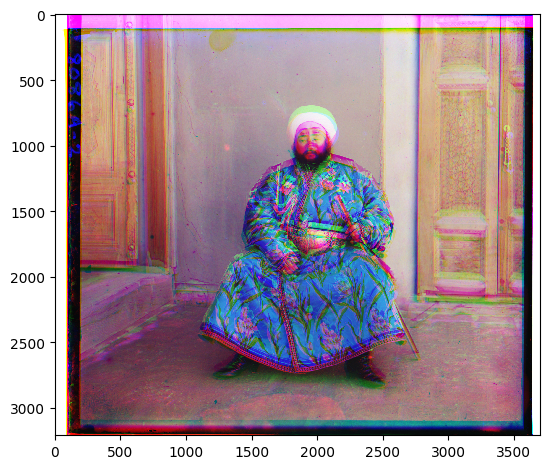

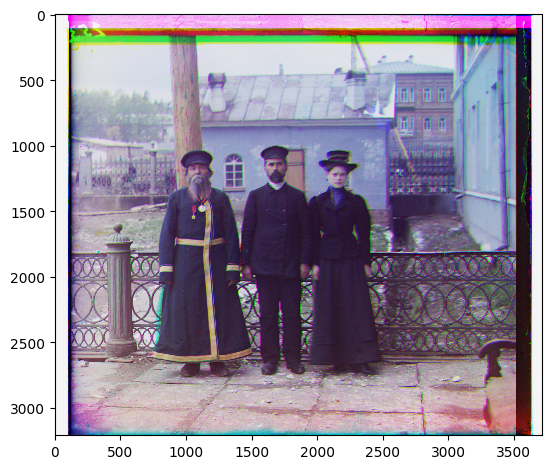

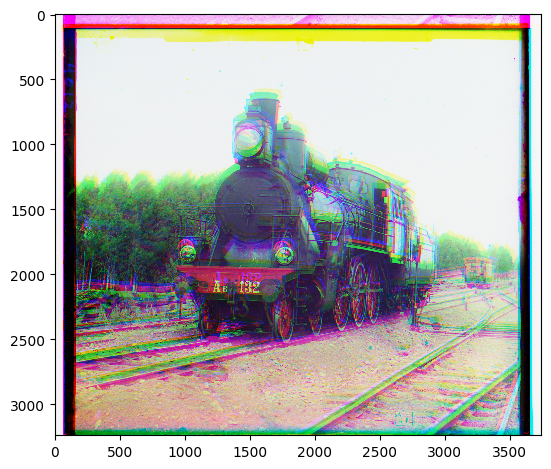

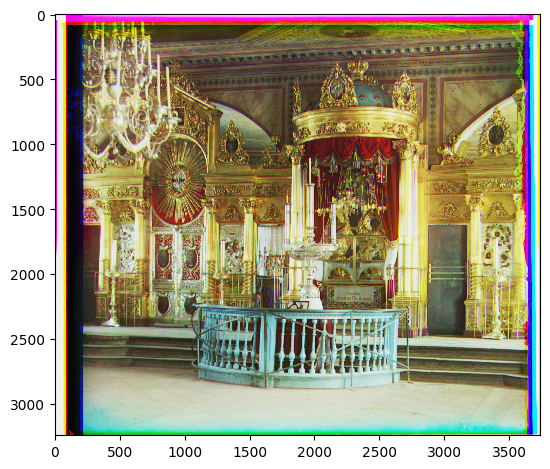

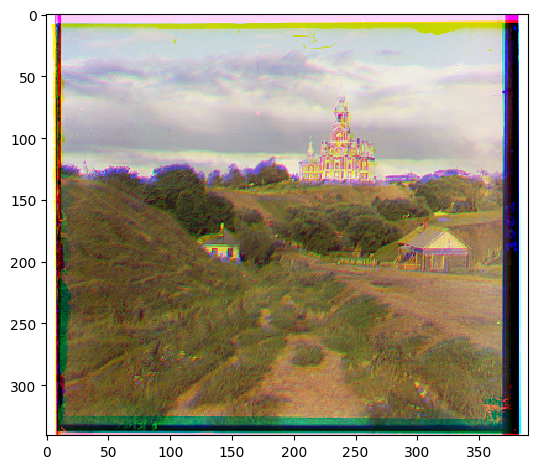

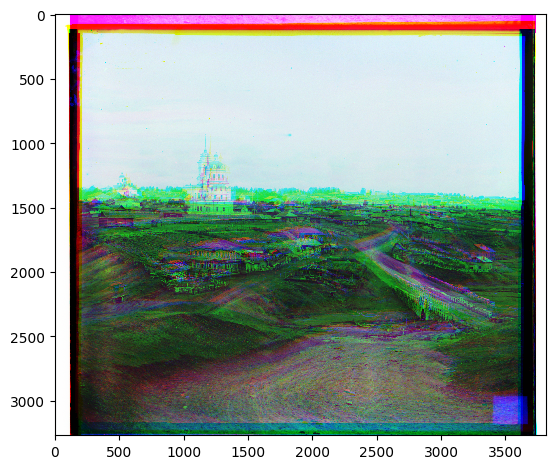

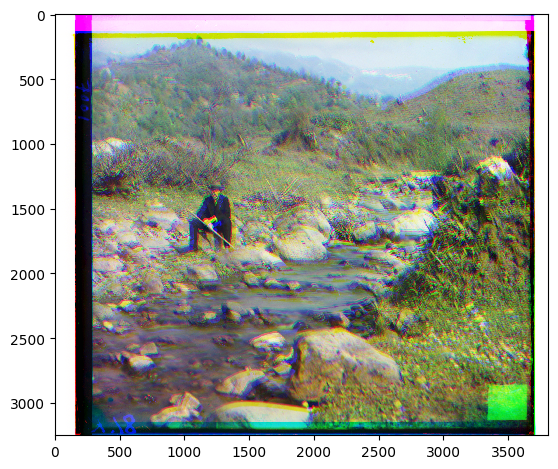

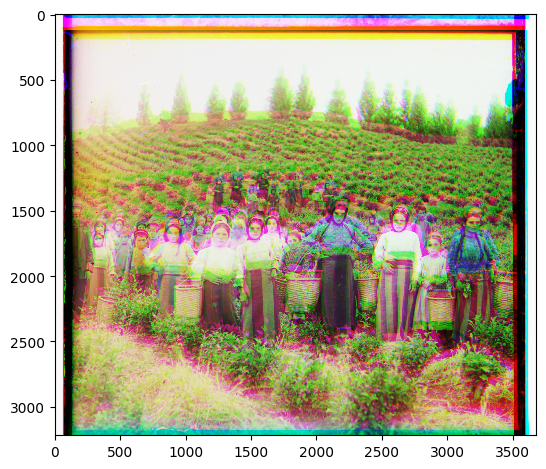

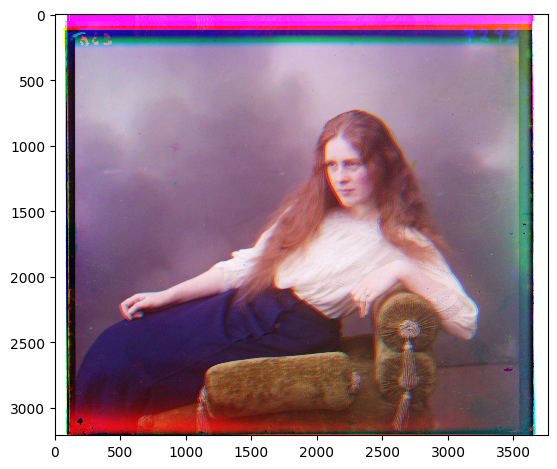

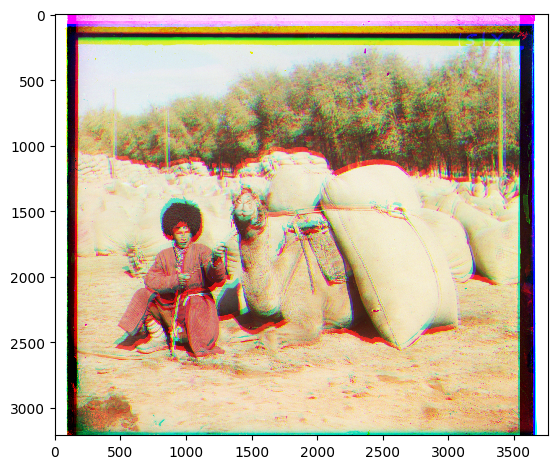

In [86]:


stack_algo = partial(ssd_brute_force_stack)
output_file_prefix = 'ssd'

for imfname in os.listdir('data'):
    # name of the input file
    impath = f'data/{imfname}'
    imtitle = os.path.splitext(imfname)[0]
    # print(imtitle)

    # read in the image
    im = skio.imread(impath)
    r,g,b = get_channels(im)

    # align and stack
    im_out, r_shift, g_shift = stack_algo(r,g,b)

    # save the image
    output_dir = f'output/{output_file_prefix}/'
    if not os.path.isdir(output_dir):
        os.makedirs(output_dir)
    fname = os.path.join(output_dir, f'{imtitle}.jpg')

    skio.imsave(fname, im_out)
    with open(os.path.join(output_dir, f'shifts.txt'), 'a') as f:
        f.write(f'\t{r_shift=}\t{g_shift=}\t{imtitle}\n')

    # display the image
    skio.imshow(im_out)
    skio.show()

In [88]:
output_file_prefix = 'resized_original'

for imfname in os.listdir('data'):
    # name of the input file
    impath = f'data/{imfname}'
    imtitle = os.path.splitext(imfname)[0]
    # print(imtitle)

    # read in the image
    im = skio.imread(impath)

    im_out = sk.transform.rescale(im, 1/4) # scale down to reduce search space

    # save the image
    output_dir = f'output/{output_file_prefix}/'
    if not os.path.isdir(output_dir):
        os.makedirs(output_dir)
    fname = os.path.join(output_dir, f'{imtitle}.jpg')

    skio.imsave(fname, im_out)

In [28]:
rand = np.random.randint(0,10, (3,5))
print(rand)
print(rand.take(range(0-3, 3-3), axis=1, mode='wrap'))

[[4 8 3 7 9]
 [4 3 9 4 0]
 [7 2 9 4 6]]
[[3 7 9]
 [9 4 0]
 [9 4 6]]


In [47]:
#####################
# Iterative alignment using image pyramids
#####################

def ssd_align(c1, c2, center=(0,0)):
    """
    Align channels by minimizing sum of squared differences.
    L2 norm also known as the Sum of Squared Differences (SSD) distance 
    which is simply sum(sum((image1-image2).^2)) 
    where the sum is taken over the pixel values.
    """
    min_ssd = np.Inf
    argmin_dh = 0
    argmin_dw = 0
    for dh in range(-2,3):
        for dw in range(-2,3):
            shifted = np.roll(c1, center[0]+dh, axis=0)
            shifted = np.roll(shifted, center[1]+dw, axis=1)
            ssd = np.sum(np.power(c2-shifted, 2))
            if ssd > min_ssd:
                continue
            min_ssd = ssd
            argmin_dh = dh
            argmin_dw = dw
        print(f"{dh=} {min_ssd=}")
    return np.array((center[0]+argmin_dh, center[1]+argmin_dw))


def ncc_align(c1, c2, center=(0,0)):
    """
    Align channels by minimizing sum of squared differences.
    L2 norm also known as the Sum of Squared Differences (SSD) distance 
    which is simply sum(sum((image1-image2).^2)) 
    where the sum is taken over the pixel values.
    """

    def preprocess(channel):
        return (channel-channel.mean())/channel.std() # normalizem

    c1 = preprocess(c1)
    c2 = preprocess(c2)
    min_ssd = np.Inf
    argmin_dh = 0
    argmin_dw = 0
    for dh in range(-2,3):
        for dw in range(-2,3):
            shifted = np.roll(c1, center[0]+dh, axis=0)
            shifted = np.roll(shifted, center[1]+dw, axis=1)
            ssd = np.sum(np.power(c2-shifted, 2))
            if ssd > min_ssd:
                continue
            min_ssd = ssd
            argmin_dh = dh
            argmin_dw = dw
        print(f"{dh=} {min_ssd=}")
    return np.array((center[0]+argmin_dh, center[1]+argmin_dw))


def ncc_mirror_align(c1, c2, center=(0,0)):
    """
    Align channels by minimizing sum of squared differences.
    L2 norm also known as the Sum of Squared Differences (SSD) distance 
    which is simply sum(sum((image1-image2).^2)) 
    where the sum is taken over the pixel values.
    """

    def preprocess(channel):
        return (channel-channel.mean())/channel.std() # normalizem

    c1 = preprocess(c1)
    c2 = preprocess(c2)
    min_ssd = np.Inf
    argmin_dh = 0
    argmin_dw = 0
    for dh in range(-2,3):
        for dw in range(-2,3):
            shifted = mirror_roll(c1, center[0]+dh, axis=0)
            shifted = mirror_roll(shifted, center[1]+dw, axis=1)
            ssd = np.sum(np.power(c2-shifted, 2))
            if ssd > min_ssd:
                continue
            min_ssd = ssd
            argmin_dh = dh
            argmin_dw = dw
        print(f"{dh=} {min_ssd=}")
    return np.array((center[0]+argmin_dh, center[1]+argmin_dw))

def iterative_align(r,g,b, align=ssd_align, depth=6):
    # depth = int(np.log2(np.min(r.shape)/10))
    # print(f"{depth=}")
    if depth == 0:
        return np.array([0,0]), np.array([0,0])

    # first align on smaller resolution / larger features
    half_r = sk.transform.rescale(r, 1/2)
    half_g = sk.transform.rescale(g, 1/2)
    half_b = sk.transform.rescale(b, 1/2)
    r_shift, g_shift = iterative_align(half_r, half_g, half_b, align, depth-1)

    # align on bigger resolution / smaller features
    r_shift = align(r,b, r_shift*2)
    g_shift = align(g,b, g_shift*2)
    print(f"{depth=} {r_shift=} {g_shift=}")

    return r_shift, g_shift

def mirror_roll(channel, distance, axis):
    """Usage: shifted = mirror_roll(c1, center[0]+dh, axis=0)"""
    shape = channel.shape
    pad_width = [[0,0],[0,0]]
    direction = int(distance > 0)
    pad_width[axis][direction] = np.abs(distance)
    padded = np.pad(channel, pad_width, mode='reflect')
    cropped = padded.take(range(distance, shape[axis]+distance), axis=axis, mode='wrap')
    return cropped


def shift_image(channel, shift, shift_fn=np.roll):
    channel = shift_fn(channel, shift[0], 0)
    channel = shift_fn(channel, shift[1], 1)
    return channel

dh=-2 min_ssd=1009.7433216797581
dh=-1 min_ssd=788.8539432449022
dh=0 min_ssd=788.8539432449022
dh=1 min_ssd=788.8539432449022
dh=2 min_ssd=788.8539432449022
dh=-2 min_ssd=794.089234842635
dh=-1 min_ssd=730.8027176896585
dh=0 min_ssd=295.46647999850234
dh=1 min_ssd=295.46647999850234
dh=2 min_ssd=295.46647999850234
depth=1 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=3500.1915371200907
dh=-1 min_ssd=3500.1915371200907
dh=0 min_ssd=2983.3716584940753
dh=1 min_ssd=2498.7228971305035
dh=2 min_ssd=2498.7228971305035
dh=-2 min_ssd=2539.2695093054526
dh=-1 min_ssd=2285.2570898459953
dh=0 min_ssd=1141.3018651695215
dh=1 min_ssd=1141.3018651695215
dh=2 min_ssd=1141.3018651695215
depth=2 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=12703.67406101714
dh=-1 min_ssd=10798.457851298917
dh=0 min_ssd=10659.958619623512
dh=1 min_ssd=10659.958619623512
dh=2 min_ssd=10659.958619623512
dh=-2 min_ssd=9879.760636007411
dh=-1 min_ssd=7485.300233611244
dh=0 min_ssd=5661.14398602

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


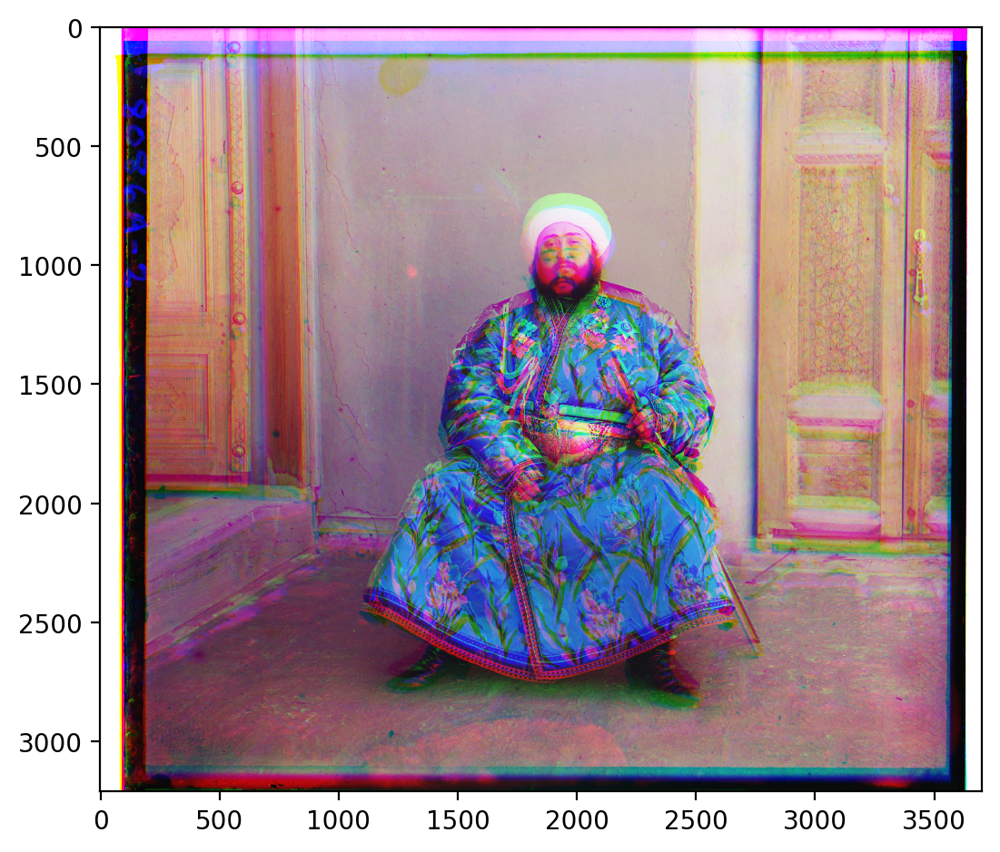

dh=-2 min_ssd=524.7498886880176
dh=-1 min_ssd=327.7811692251114
dh=0 min_ssd=327.7811692251114
dh=1 min_ssd=327.7811692251114
dh=2 min_ssd=327.7811692251114
dh=-2 min_ssd=552.540837613591
dh=-1 min_ssd=351.8432342311493
dh=0 min_ssd=228.36536006706496
dh=1 min_ssd=228.36536006706496
dh=2 min_ssd=228.36536006706496
depth=1 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=2251.617987656211
dh=-1 min_ssd=2251.617987656211
dh=0 min_ssd=1629.2989217616148
dh=1 min_ssd=662.2765065724994
dh=2 min_ssd=662.2765065724994
dh=-2 min_ssd=1566.8212039375667
dh=-1 min_ssd=815.2034634506915
dh=0 min_ssd=815.2034634506915
dh=1 min_ssd=815.2034634506915
dh=2 min_ssd=815.2034634506915
depth=2 r_shift=array([-1,  0]) g_shift=array([-1,  0])
dh=-2 min_ssd=7027.972901062149
dh=-1 min_ssd=4269.717897532874
dh=0 min_ssd=3627.5698405578523
dh=1 min_ssd=3627.5698405578523
dh=2 min_ssd=3627.5698405578523
dh=-2 min_ssd=6353.246614224348
dh=-1 min_ssd=5202.9535233684655
dh=0 min_ssd=4551.992176416099
dh

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


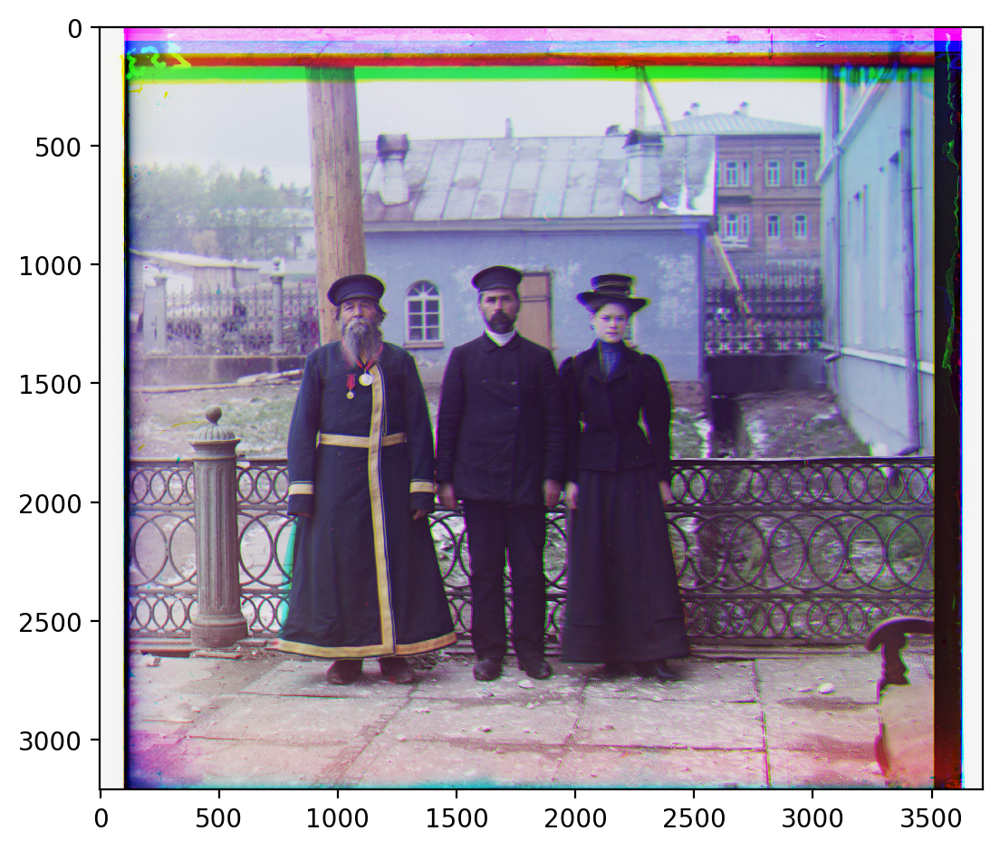

dh=-2 min_ssd=463.7548720821094
dh=-1 min_ssd=300.78992294933283
dh=0 min_ssd=300.78992294933283
dh=1 min_ssd=300.78992294933283
dh=2 min_ssd=300.78992294933283
dh=-2 min_ssd=518.8168844710732
dh=-1 min_ssd=298.47598848588495
dh=0 min_ssd=197.839773483682
dh=1 min_ssd=197.839773483682
dh=2 min_ssd=197.839773483682
depth=1 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=1853.4806393787962
dh=-1 min_ssd=1853.4806393787962
dh=0 min_ssd=1687.9755302029562
dh=1 min_ssd=1041.4863218597757
dh=2 min_ssd=1041.4863218597757
dh=-2 min_ssd=1423.8174558949954
dh=-1 min_ssd=1285.5451604935993
dh=0 min_ssd=1025.7593543259022
dh=1 min_ssd=1025.7593543259022
dh=2 min_ssd=1025.7593543259022
depth=2 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=7549.600685775729
dh=-1 min_ssd=6092.797955219496
dh=0 min_ssd=4699.704668049686
dh=1 min_ssd=4699.704668049686
dh=2 min_ssd=4699.704668049686
dh=-2 min_ssd=5869.975297414223
dh=-1 min_ssd=4601.069891509287
dh=0 min_ssd=4601.069891509287


Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


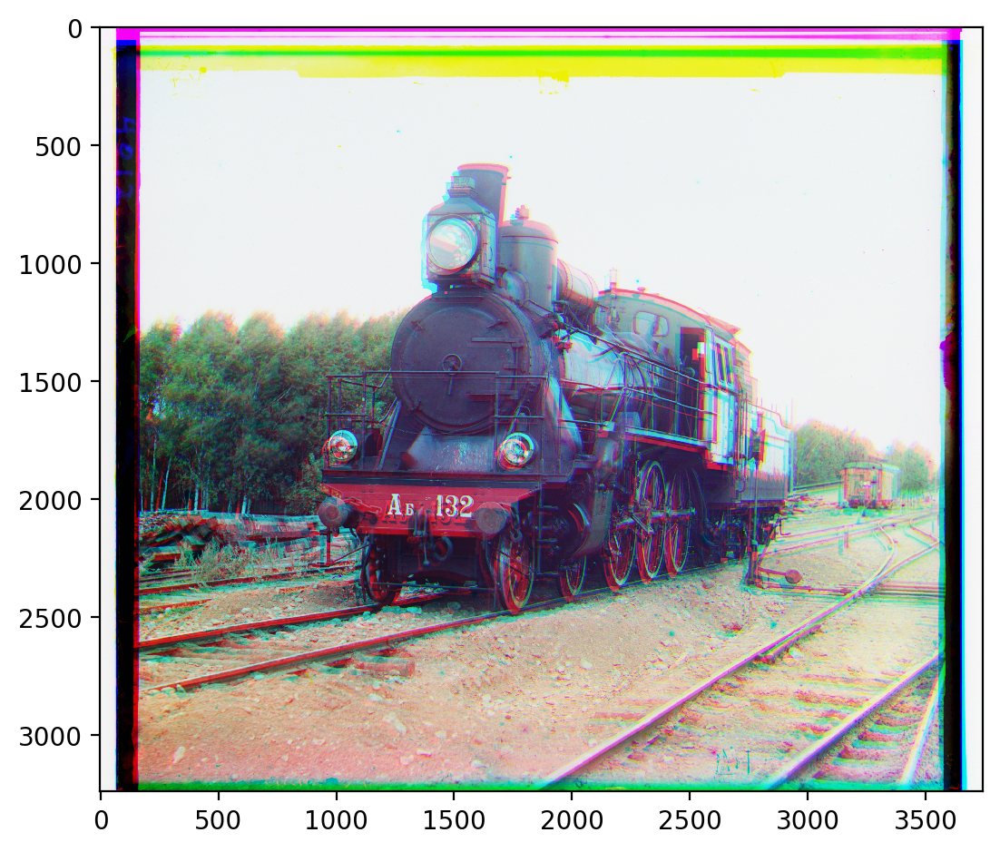

dh=-2 min_ssd=1324.4981036376423
dh=-1 min_ssd=781.6958282314665
dh=0 min_ssd=681.3940282890915
dh=1 min_ssd=681.3940282890915
dh=2 min_ssd=681.3940282890915
dh=-2 min_ssd=1124.8585979976442
dh=-1 min_ssd=611.7552468277692
dh=0 min_ssd=250.67227802934573
dh=1 min_ssd=250.67227802934573
dh=2 min_ssd=250.67227802934573
depth=1 r_shift=array([0, 0]) g_shift=array([0, 0])
dh=-2 min_ssd=3592.793230605902
dh=-1 min_ssd=1978.9533572868818
dh=0 min_ssd=1978.9533572868818
dh=1 min_ssd=1978.9533572868818
dh=2 min_ssd=1978.9533572868818
dh=-2 min_ssd=2481.201365413094
dh=-1 min_ssd=1564.235586124232
dh=0 min_ssd=1472.6220391077732
dh=1 min_ssd=1472.6220391077732
dh=2 min_ssd=1472.6220391077732
depth=2 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=16287.478791308182
dh=-1 min_ssd=12427.820824232454
dh=0 min_ssd=9291.987351456744
dh=1 min_ssd=9291.987351456744
dh=2 min_ssd=9291.987351456744
dh=-2 min_ssd=8175.23013221434
dh=-1 min_ssd=6325.2245171230925
dh=0 min_ssd=6325.2245171230925

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


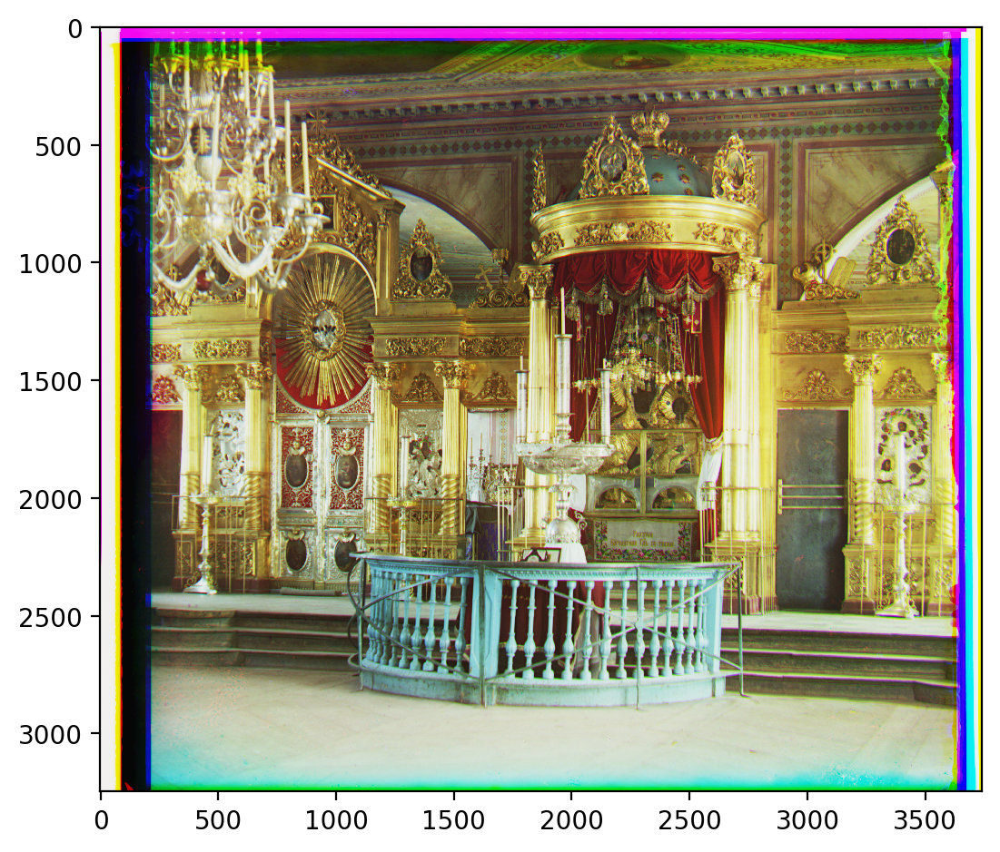

dh=-2 min_ssd=0.2940350974556821
dh=-1 min_ssd=0.2940350974556821
dh=0 min_ssd=0.2940350974556821
dh=1 min_ssd=0.2940350974556821
dh=2 min_ssd=0.2940350974556821
dh=-2 min_ssd=0.047410503338521405
dh=-1 min_ssd=0.047410503338521405
dh=0 min_ssd=0.047410503338521405
dh=1 min_ssd=0.047410503338521405
dh=2 min_ssd=0.047410503338521405
depth=1 r_shift=array([2, 0]) g_shift=array([2, 0])
dh=-2 min_ssd=41.4618247799933
dh=-1 min_ssd=41.4618247799933
dh=0 min_ssd=41.4618247799933
dh=1 min_ssd=41.4618247799933
dh=2 min_ssd=41.4618247799933
dh=-2 min_ssd=43.13243259770365
dh=-1 min_ssd=43.13243259770365
dh=0 min_ssd=43.13243259770365
dh=1 min_ssd=43.13243259770365
dh=2 min_ssd=43.13243259770365
depth=2 r_shift=array([2, 2]) g_shift=array([2, 2])
dh=-2 min_ssd=105.37773991460335
dh=-1 min_ssd=105.37773991460335
dh=0 min_ssd=105.37773991460335
dh=1 min_ssd=105.37773991460335
dh=2 min_ssd=105.37773991460335
dh=-2 min_ssd=91.17454922604726
dh=-1 min_ssd=91.17454922604726
dh=0 min_ssd=91.17454922604

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


dh=1 min_ssd=135158.3357453107
dh=2 min_ssd=135158.3357453107
depth=8 r_shift=array([  2, 193]) g_shift=array([  9, 193])


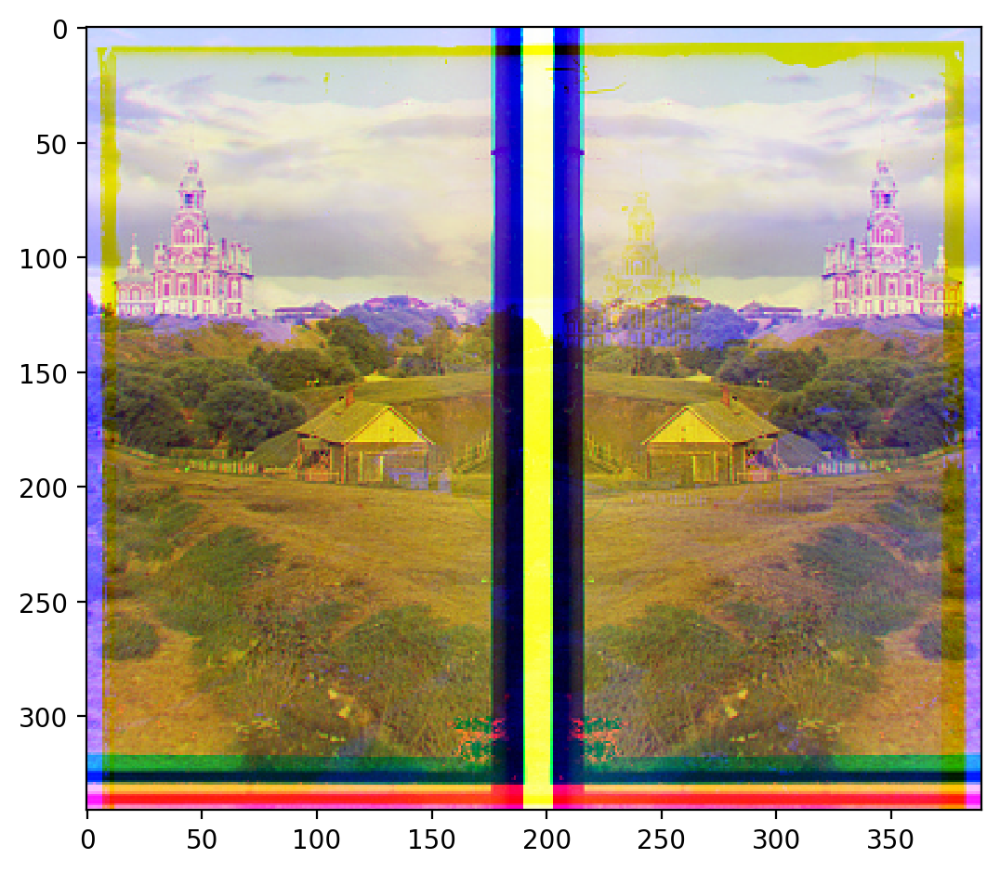

dh=-2 min_ssd=317.92994570037
dh=-1 min_ssd=117.60872067562458
dh=0 min_ssd=117.60872067562458
dh=1 min_ssd=117.60872067562458
dh=2 min_ssd=117.60872067562458
dh=-2 min_ssd=435.26124733525313
dh=-1 min_ssd=167.96413022500712
dh=0 min_ssd=95.34813156221246
dh=1 min_ssd=95.34813156221246
dh=2 min_ssd=95.34813156221246
depth=1 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=1349.118984714541
dh=-1 min_ssd=1333.2889908280883
dh=0 min_ssd=741.157421436032
dh=1 min_ssd=509.54770778446243
dh=2 min_ssd=509.54770778446243
dh=-2 min_ssd=807.5925490386564
dh=-1 min_ssd=746.8126822658306
dh=0 min_ssd=551.4227691311175
dh=1 min_ssd=551.4227691311175
dh=2 min_ssd=551.4227691311175
depth=2 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=3654.463192158548
dh=-1 min_ssd=2823.893818215558
dh=0 min_ssd=2527.7839720086295
dh=1 min_ssd=2527.7839720086295
dh=2 min_ssd=2527.7839720086295
dh=-2 min_ssd=3648.098051908489
dh=-1 min_ssd=2370.1708103569154
dh=0 min_ssd=2370.1708103569154
d

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


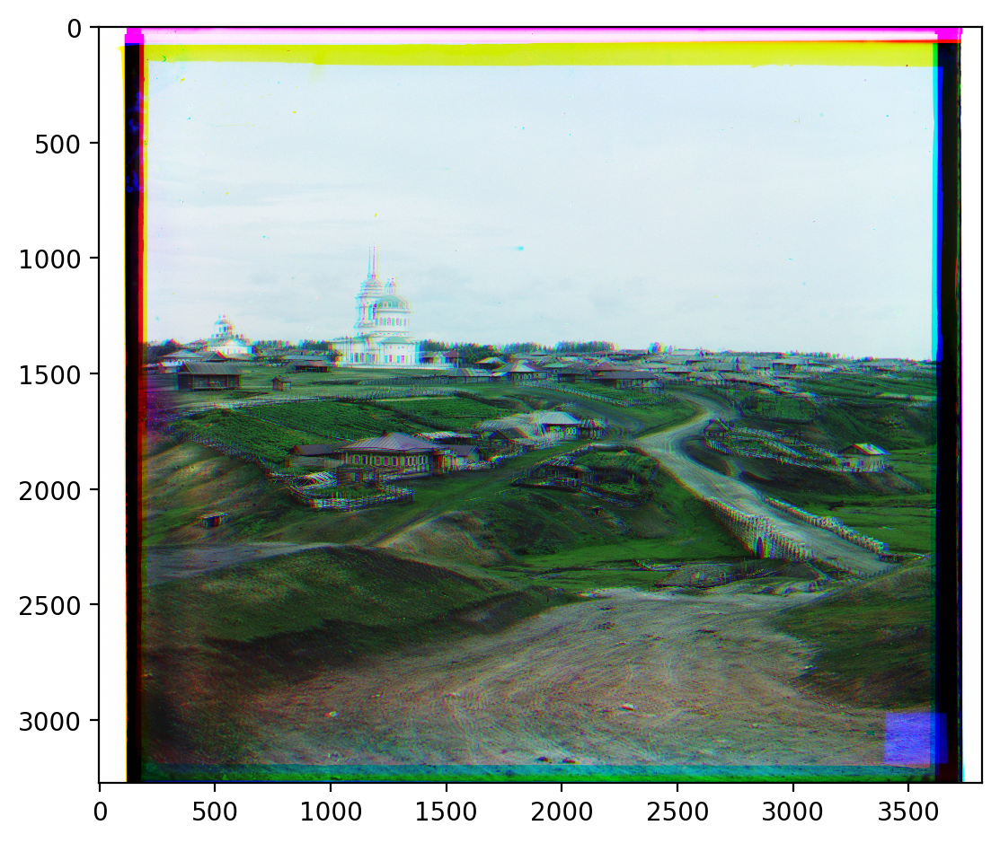

dh=-2 min_ssd=878.875598276329
dh=-1 min_ssd=182.5471556002949
dh=0 min_ssd=182.5471556002949
dh=1 min_ssd=182.5471556002949
dh=2 min_ssd=182.5471556002949
dh=-2 min_ssd=779.7558084003001
dh=-1 min_ssd=557.9665232575973
dh=0 min_ssd=291.509610578619
dh=1 min_ssd=291.509610578619
dh=2 min_ssd=291.509610578619
depth=1 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=3486.915993506991
dh=-1 min_ssd=2479.64022120223
dh=0 min_ssd=1032.5446284053373
dh=1 min_ssd=1032.5446284053373
dh=2 min_ssd=1032.5446284053373
dh=-2 min_ssd=2426.6556480955232
dh=-1 min_ssd=1331.376157586006
dh=0 min_ssd=1331.376157586006
dh=1 min_ssd=1331.376157586006
dh=2 min_ssd=1331.376157586006
depth=2 r_shift=array([-2,  0]) g_shift=array([-1,  0])
dh=-2 min_ssd=10215.20016073866
dh=-1 min_ssd=7417.761531872158
dh=0 min_ssd=5094.682780884492
dh=1 min_ssd=4040.558121696098
dh=2 min_ssd=4040.558121696098
dh=-2 min_ssd=10067.756293001337
dh=-1 min_ssd=8905.549377414116
dh=0 min_ssd=6144.184973874408
dh=1 min_s

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


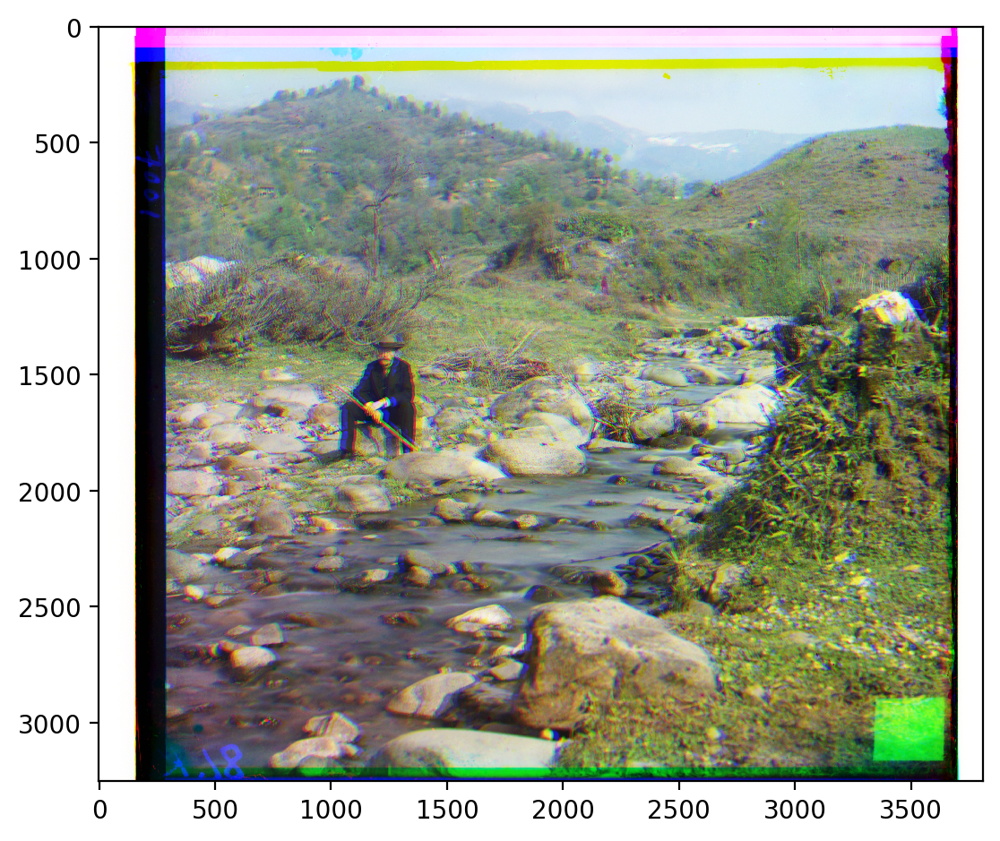

dh=-2 min_ssd=916.9099396443088
dh=-1 min_ssd=435.96640321233974
dh=0 min_ssd=435.96640321233974
dh=1 min_ssd=435.96640321233974
dh=2 min_ssd=435.96640321233974
dh=-2 min_ssd=923.4687312860603
dh=-1 min_ssd=579.3328279150362
dh=0 min_ssd=285.7260280685198
dh=1 min_ssd=285.7260280685198
dh=2 min_ssd=285.7260280685198
depth=1 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=3065.5622785405035
dh=-1 min_ssd=3065.5622785405035
dh=0 min_ssd=2286.4605378225324
dh=1 min_ssd=1303.2986711831472
dh=2 min_ssd=1303.2986711831472
dh=-2 min_ssd=2429.7977865353223
dh=-1 min_ssd=1460.5580448547983
dh=0 min_ssd=1460.5580448547983
dh=1 min_ssd=1460.5580448547983
dh=2 min_ssd=1460.5580448547983
depth=2 r_shift=array([-1,  0]) g_shift=array([-1,  0])
dh=-2 min_ssd=9949.108029407695
dh=-1 min_ssd=6697.1525595719395
dh=0 min_ssd=5594.718995064037
dh=1 min_ssd=5594.718995064037
dh=2 min_ssd=5594.718995064037
dh=-2 min_ssd=10124.795534373307
dh=-1 min_ssd=9203.146658287224
dh=0 min_ssd=6682.2213461

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


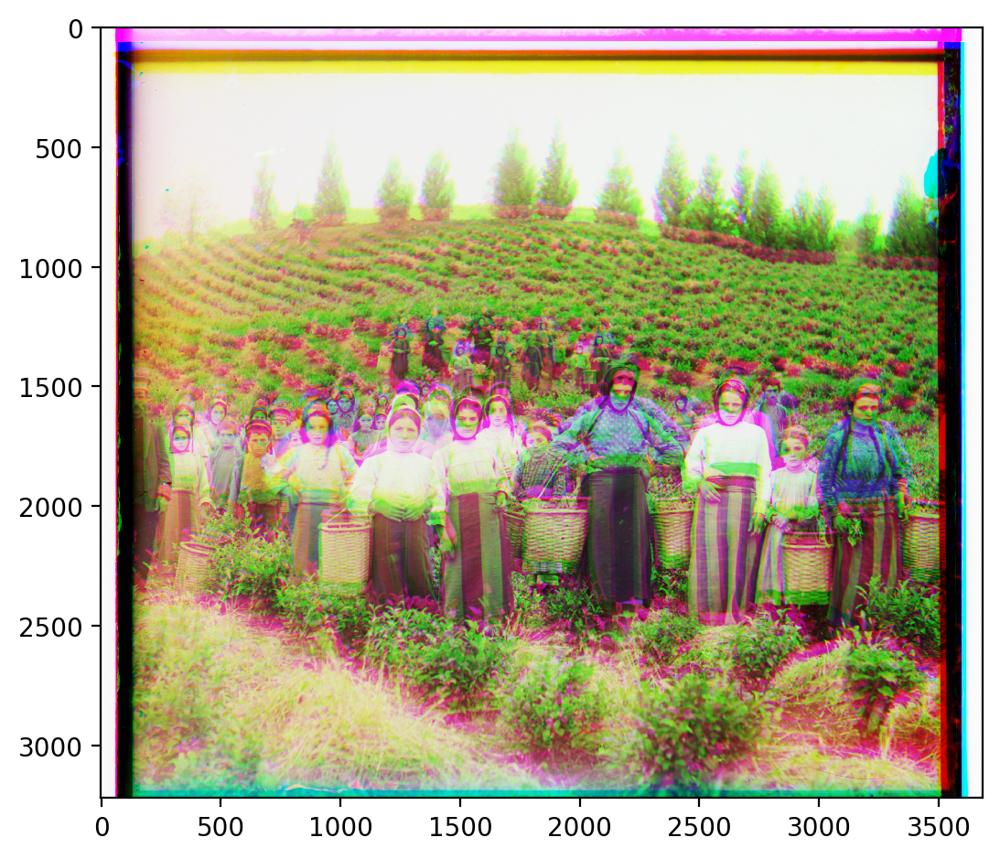

dh=-2 min_ssd=839.508824711977
dh=-1 min_ssd=500.2196334797415
dh=0 min_ssd=500.2196334797415
dh=1 min_ssd=500.2196334797415
dh=2 min_ssd=500.2196334797415
dh=-2 min_ssd=1008.4226219128191
dh=-1 min_ssd=627.9745899635568
dh=0 min_ssd=282.7575211842073
dh=1 min_ssd=282.7575211842073
dh=2 min_ssd=282.7575211842073
depth=1 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=3469.6806310962256
dh=-1 min_ssd=3149.6903628010755
dh=0 min_ssd=2253.7517944985943
dh=1 min_ssd=1599.7374834925113
dh=2 min_ssd=1599.7374834925113
dh=-2 min_ssd=2690.6400388756856
dh=-1 min_ssd=1549.0333315235987
dh=0 min_ssd=1263.0376133191144
dh=1 min_ssd=1263.0376133191144
dh=2 min_ssd=1263.0376133191144
depth=2 r_shift=array([-1,  0]) g_shift=array([0, 0])
dh=-2 min_ssd=9711.525232622203
dh=-1 min_ssd=7965.178805403575
dh=0 min_ssd=6831.783722247797
dh=1 min_ssd=6831.783722247797
dh=2 min_ssd=6831.783722247797
dh=-2 min_ssd=6678.315442992956
dh=-1 min_ssd=4764.9411136437175
dh=0 min_ssd=4764.9411136437175


Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


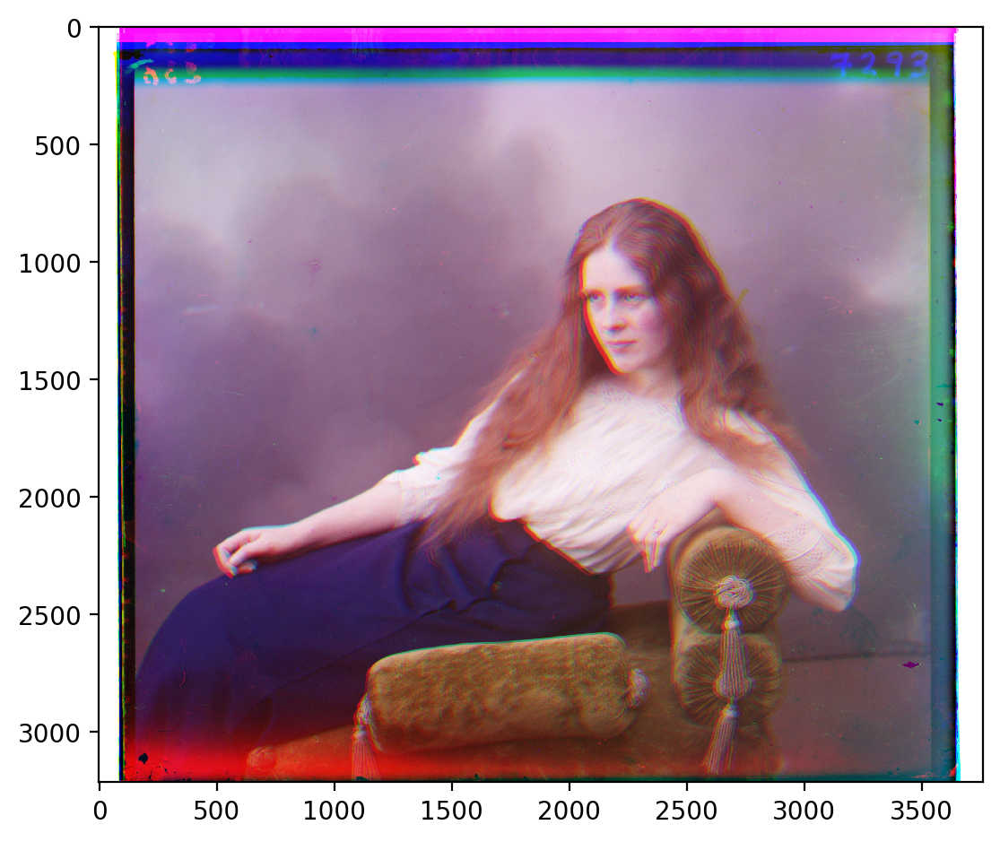

dh=-2 min_ssd=1197.863550032869
dh=-1 min_ssd=817.5317054467885
dh=0 min_ssd=637.1401463797895
dh=1 min_ssd=637.1401463797895
dh=2 min_ssd=637.1401463797895
dh=-2 min_ssd=1294.8579301108248
dh=-1 min_ssd=884.6488511268958
dh=0 min_ssd=343.0684832516192
dh=1 min_ssd=343.0684832516192
dh=2 min_ssd=343.0684832516192
depth=1 r_shift=array([0, 0]) g_shift=array([0, 0])
dh=-2 min_ssd=3602.4753315243406
dh=-1 min_ssd=1605.757807115157
dh=0 min_ssd=1605.757807115157
dh=1 min_ssd=1605.757807115157
dh=2 min_ssd=1605.757807115157
dh=-2 min_ssd=3394.7361371234656
dh=-1 min_ssd=1443.595588237628
dh=0 min_ssd=1443.595588237628
dh=1 min_ssd=1443.595588237628
dh=2 min_ssd=1443.595588237628
depth=2 r_shift=array([-1,  0]) g_shift=array([-1,  0])
dh=-2 min_ssd=13828.459202976821
dh=-1 min_ssd=10454.70233732681
dh=0 min_ssd=7690.3392546276755
dh=1 min_ssd=7078.264619566729
dh=2 min_ssd=7078.264619566729
dh=-2 min_ssd=12865.999061845923
dh=-1 min_ssd=9820.635806048283
dh=0 min_ssd=7210.290620687509
dh=1 m

Lossy conversion from float64 to uint8. Range [0, 1]. Convert image to uint8 prior to saving to suppress this warning.


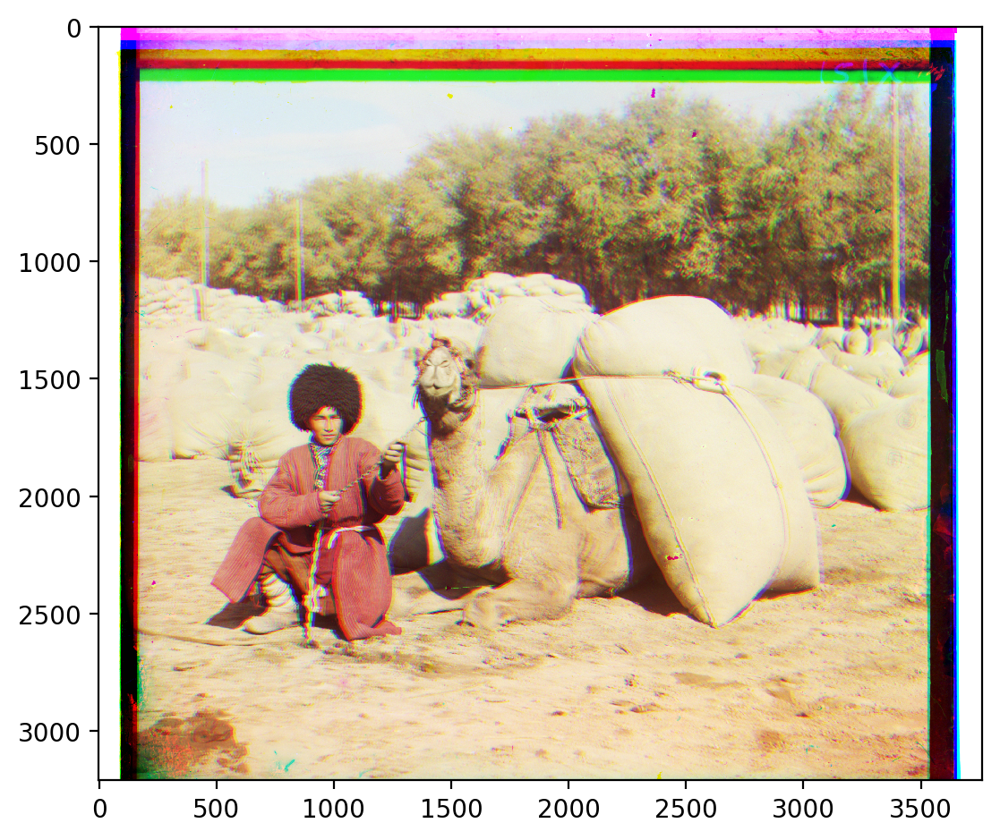

In [51]:


stack_algo = partial(iterative_align, align=ncc_mirror_align, depth=8)
output_file_prefix = 'ncc_pyramid_mirror'
crop = False

for imfname in os.listdir('data'):
    # name of the input file
    impath = f'data/{imfname}'
    imtitle = os.path.splitext(imfname)[0]
    # print(imtitle)

    # read in the image
    im = skio.imread(impath)
    r,g,b = get_channels(im)
    if crop:
        def crop(channel):
            h, w = channel.shape
            return channel[h//10:h-h//10, w//10:w-w//10] # only keep center 80%
        r,g,b = [crop(c) for c in (r,g,b)]

    # get image pyramids
    r_shift, g_shift = stack_algo(r,g,b)
    r_shifted = shift_image(r, r_shift, shift_fn=mirror_roll)
    g_shifted = shift_image(g, g_shift, shift_fn=mirror_roll)
    im_out = np.dstack([r_shifted, g_shifted, b])
    
    # save the image
    output_dir = f'output/{output_file_prefix}/'
    if not os.path.isdir(output_dir):
        os.makedirs(output_dir)
    fname = os.path.join(output_dir, f'{imtitle}.jpg')

    skio.imsave(fname, im_out)
    with open(os.path.join(output_dir, f'shifts.txt'), 'a') as f:
        f.write(f'\t{r_shift=}\t{g_shift=}\t{imtitle}\n')

    # display the image
    skio.imshow(im_out)
    skio.show()